# Set-up

In [1]:
# Basic imports
import pandas as pd
from tqdm.notebook import trange, tqdm
import os
from os.path import join

# Plotting imports
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.subplots as sp
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

# Calendar imports
from datetime import datetime, timedelta
import calendar
import time
from workalendar.europe import Italy
import holidays

# Scraping imports
import requests
from urllib.error import HTTPError

# Geomedian imports
import numpy as np
from utils import geometric_median, geometric_medoid

# FDA imports
import skfda
from skfda.exploratory.visualization import FPCAPlot
from skfda.preprocessing.dim_reduction import FPCA
from sklearn.metrics import pairwise_distances_argmin

# Statsmodels imports
import statsmodels.api as sm
from statsmodels.tsa.seasonal import STL

In [2]:
weekday_mapping = {
    0: "Monday",
    1: "Tuesday",
    2: "Wednesday",
    3: "Thursday",
    4: "Friday",
    5: "Saturday",
    6: "Sunday"
}

In [3]:
month_mapping = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

In [4]:
pd.options.mode.chained_assignment = None

# Functions

In [5]:
year_zone_system = {
    2018: 2012,
    2019: 2012,
    2020: 2012,
    2021: 2021,
    2022: 2021
}

In [6]:
def get_load_data(url, headers, date_from, date_to):
    """Gets Terna load data from date_from to date_to by making a get requests to url with headers"""
    params = {'dateFrom': date_from, 'dateTo': date_to}
    r = requests.get(url, headers=headers, params=params)
    if r.status_code != 200:
        print(r.text)
        r.raise_for_status()
    df = pd.DataFrame(r.json()['totalLoad'])
    return df

In [7]:
def get_string_color(color, opacity=1):
    r, g, b = tuple(int(value * 255) for value in color)
    return f'rgba({r}, {g}, {b}, {opacity})'

In [8]:
# Matplotlib 'cool' palette
cool_matplotlib = plt.cm.cool(range(256))

# Extract every 16th color to get a subset
subset_cool_matplotlib = cool_matplotlib[::256//11]

# Convert Matplotlib color format to Seaborn color format
cool_palette = sns.color_palette(subset_cool_matplotlib)
cool_palette

[(0.0, 1.0, 1.0),
 (0.09019607843137255, 0.9098039215686274, 1.0),
 (0.1803921568627451, 0.8196078431372549, 1.0),
 (0.27058823529411763, 0.7294117647058824, 1.0),
 (0.3607843137254902, 0.6392156862745098, 1.0),
 (0.45098039215686275, 0.5490196078431373, 1.0),
 (0.5411764705882353, 0.45882352941176474, 1.0),
 (0.6313725490196078, 0.3686274509803922, 1.0),
 (0.7215686274509804, 0.2784313725490196, 1.0),
 (0.8117647058823529, 0.18823529411764706, 1.0),
 (0.9019607843137255, 0.0980392156862745, 1.0),
 (0.9921568627450981, 0.007843137254901933, 1.0)]

In [9]:
deep_palette = sns.color_palette('deep')

# Collect data

## Load data

### From API

In [12]:
# API account parameters
access_url = 'https://api.terna.it/transparency/oauth/accessToken'
API_KEY = '***REMOVED***'
SECRET = '***REMOVED***'
payload = f'grant_type=client_credentials&client_id={API_KEY}&client_secret={SECRET}'
access_headers = {'Content-Type': 'application/x-www-form-urlencoded'}

In [21]:
r_access = requests.post(access_url, headers=access_headers, data=payload)
r_access.raise_for_status()

time.sleep(1) # We need to sleep one second otherwise we get blocked
headers = {'Authorization': 'Bearer {}'.format(r_access.json()['access_token'])}

In [22]:
# Load endpoint URL and headers
url = 'https://api.terna.it/transparency/v1.0/gettotalload'
headers = {'Authorization': 'Bearer {}'.format(r_access.json()['access_token'])}

In [23]:
# years = [2023, 2022, 2021, 2020, 2019]
years = [2023]
months = range(1,13)
# months = [1]

df_list = []

for year in tqdm(years):
    for month in tqdm(months):
        date_from = datetime(year, month, 1)
        _, days_in_month = calendar.monthrange(year, month)
        date_to = date_from + timedelta(days=days_in_month-1)
        date_from, date_to = date_from.strftime('%d/%m/%Y'), date_to.strftime('%d/%m/%Y')
        
        print(f"Fetching data from {date_from} to {date_to}...")
        try:
            time.sleep(1)
            df_list.append(get_load_data(url, headers, date_from, date_to))
        except Exception as e:
            print(e)
            r_access = requests.post(access_url, headers=access_headers, data=payload)
            headers = {'Authorization': 'Bearer {}'.format(r_access.json()['access_token'])}
            time.sleep(1)
            df_list.append(get_load_data(url, headers, date_from, date_to))     
print("Done")

df = pd.concat(df_list, ignore_index=True)
df

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

Fetching data from 01/01/2023 to 31/01/2023...
Fetching data from 01/02/2023 to 28/02/2023...
Fetching data from 01/03/2023 to 31/03/2023...
Fetching data from 01/04/2023 to 30/04/2023...
Fetching data from 01/05/2023 to 31/05/2023...
Fetching data from 01/06/2023 to 30/06/2023...
Fetching data from 01/07/2023 to 31/07/2023...
Fetching data from 01/08/2023 to 31/08/2023...
Fetching data from 01/09/2023 to 30/09/2023...
Fetching data from 01/10/2023 to 31/10/2023...
Fetching data from 01/11/2023 to 30/11/2023...
Fetching data from 01/12/2023 to 31/12/2023...
Done


,Date,Total_Load_MW,Forecast_Total_Load_MW,Bidding_Zone
0,2023-01-31 23:45:00,32581.999,33214,Italy
1,2023-01-31 23:45:00,18308.467,18663.601,North
2,2023-01-31 23:45:00,885.929,903.114,Sardinia
3,2023-01-31 23:45:00,2296.677,2341.226,South
4,2023-01-31 23:45:00,2654.9,2706.397,Centre-North
...,...,...,...,...
280815,2023-12-01 00:00:00,30070.001,31501,Italy
280816,2023-12-01 00:00:00,17003.081,17812.24,North
280817,2023-12-01 00:00:00,788.862,826.403,Sardinia
280818,2023-12-01 00:00:00,1756.459,1840.047,Sicily


In [18]:
df_list_1 = df_list[:]

In [25]:
df = pd.concat([df, pd.concat(df_list_1, ignore_index=True)], ignore_index=True)
df

,Date,Total_Load_MW,Forecast_Total_Load_MW,Bidding_Zone
0,2023-01-31 23:45:00,32581.999,33214,Italy
1,2023-01-31 23:45:00,18308.467,18663.601,North
2,2023-01-31 23:45:00,885.929,903.114,Sardinia
3,2023-01-31 23:45:00,2296.677,2341.226,South
4,2023-01-31 23:45:00,2654.9,2706.397,Centre-North
...,...,...,...,...
1334186,2019-12-01 00:00:00,14709.874,15056.671,North
1334187,2019-12-01 00:00:00,27400.999,28047,Italy
1334188,2019-12-01 00:00:00,4386.895,4490.32,Centre-South
1334189,2019-12-01 00:00:00,2855.863,2923.192,Centre-North


In [26]:
df['Date'] = df.Date.astype('datetime64[ns]')
df = df[df.Date.dt.minute == 0] # The original granularity of the data is the hour and 15-min interval values are just interpolated
df['Total_Load_MW'] = df['Total_Load_MW'].astype(float)
df.drop('Forecast_Total_Load_MW', axis=1, inplace=True)
df.sort_values('Date', inplace=True)
df

,Date,Total_Load_MW,Bidding_Zone
1109741,2019-01-01 00:00:00,2660.928,Centre-North
1109740,2019-01-01 00:00:00,4292.272,Centre-South
1109739,2019-01-01 00:00:00,24370.000,Italy
1109738,2019-01-01 00:00:00,11776.405,North
1109737,2019-01-01 00:00:00,942.891,Sardinia
...,...,...,...
256539,2023-12-31 23:00:00,1830.478,Sicily
256538,2023-12-31 23:00:00,1729.167,South
256537,2023-12-31 23:00:00,4933.358,Centre-South
256536,2023-12-31 23:00:00,2117.042,Centre-North


In [27]:
# Check that there are no duplicates
check_dup = df.groupby(['Date', 'Bidding_Zone']).size()
check_dup[check_dup>1]

Date                 Bidding_Zone
2022-12-10 00:00:00  Calabria        2
                     Centre-North    2
                     Centre-South    2
                     Italy           2
                     North           2
                                    ..
2023-12-29 15:00:00  Italy           2
                     North           2
                     Sardinia        2
                     Sicily          2
                     South           2
Length: 512, dtype: int64

In [28]:
dup_dates = check_dup[check_dup>1].reset_index().Date.unique()
df[df.Date.isin(dup_dates)].sort_values(['Date', 'Bidding_Zone'])

,Date,Total_Load_MW,Bidding_Zone
555714,2022-12-10 00:00:00,581.927,Calabria
555725,2022-12-10 00:00:00,581.927,Calabria
555715,2022-12-10 00:00:00,2356.496,Centre-North
555721,2022-12-10 00:00:00,2356.496,Centre-North
555713,2022-12-10 00:00:00,5172.143,Centre-South
...,...,...,...
258353,2023-12-29 15:00:00,1122.002,Sardinia
258344,2023-12-29 15:00:00,2614.064,Sicily
258352,2023-12-29 15:00:00,2614.830,Sicily
258348,2023-12-29 15:00:00,2212.576,South


No idea on the origin of these duplicates, let's just drop them

In [29]:
df.drop_duplicates(inplace=True)
check_dup = df.groupby(['Date', 'Bidding_Zone']).size()
check_dup[check_dup>1]

Date                 Bidding_Zone
2023-12-29 00:00:00  Calabria        2
                     Centre-North    2
                     Centre-South    2
                     Italy           2
                     North           2
                                    ..
2023-12-29 15:00:00  Italy           2
                     North           2
                     Sardinia        2
                     Sicily          2
                     South           2
Length: 128, dtype: int64

In [30]:
df.drop_duplicates(subset=['Date', 'Bidding_Zone'], inplace=True)
check_dup = df.groupby(['Date', 'Bidding_Zone']).size()
check_dup[check_dup>1]

Series([], dtype: int64)

In [31]:
df = df.pivot(columns='Bidding_Zone', values='Total_Load_MW', index='Date')
df

Bidding_Zone,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529
...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00,791.814,2734.069,6110.321,31780.000,16288.086,1082.299,2464.776,2308.635
2023-12-31 20:00:00,757.054,2637.329,5856.124,30074.000,15265.633,1034.443,2335.105,2188.312
2023-12-31 21:00:00,674.156,2389.981,5376.828,27463.001,13917.284,958.273,2113.560,2032.919


In [32]:
df.to_csv('data/load_2019_to_2023.csv')

In [33]:
years = df.index.year.unique()
for year in tqdm(years):
    df[df.index.year == year].to_csv(f'data/source_load/refresh_202402/load_{year}.csv')

  0%|          | 0/5 [00:00<?, ?it/s]

### From downloaded file

In [11]:
folder  = "/Users/guillaume/Library/CloudStorage/OneDrive-PolitecnicodiMilano/Share/Elena - Guillaume/Fabbisogno al quarto d'ora - Terna"

df_list = []
for file in os.listdir(folder):
    df = pd.read_excel(join(folder, file))
    df_list.append(df)
df = pd.concat(df_list, ignore_index=True)
df

,ANNOMESE,DATA_QUARTO,REGIONE,FABBISOGNO100
0,202101,2021-01-01 00:00:00,CAMPANIA,428.926800
1,202101,2021-01-01 00:00:00,SICILIA,506.598536
2,202101,2021-01-01 00:00:00,BASILICATA,75.278756
3,202101,2021-01-01 00:00:00,MARCHE,149.007881
4,202101,2021-01-01 00:00:00,CALABRIA,148.858752
...,...,...,...,...
4206715,201812,2018-12-31 23:45:00,FRIULI,159.485507
4206716,201812,2018-12-31 23:45:00,CAMPANIA,465.428558
4206717,201812,2018-12-31 23:45:00,LAZIO,522.667095
4206718,201812,2018-12-31 23:45:00,BASILICATA,97.513893


In [34]:
test_df = df[(df.DATA_QUARTO.dt.date == pd.to_datetime('2022-03-11').date()) & (df.REGIONE == 'MARCHE')]

In [37]:
df = df.sort_values(by=['REGIONE', 'DATA_QUARTO'])
df

,ANNOMESE,DATA_QUARTO,REGIONE,FABBISOGNO100
3505935,201801,2018-01-01 00:00:00,ABRUZZO,130.427209
3505940,201801,2018-01-01 00:15:00,ABRUZZO,128.281197
3505961,201801,2018-01-01 00:30:00,ABRUZZO,130.751181
3505997,201801,2018-01-01 00:45:00,ABRUZZO,130.888127
3506014,201801,2018-01-01 01:00:00,ABRUZZO,131.885886
...,...,...,...,...
2805024,202312,2023-12-31 22:45:00,VENETO,478.740481
2805049,202312,2023-12-31 23:00:00,VENETO,471.162627
2805061,202312,2023-12-31 23:15:00,VENETO,466.604402
2805082,202312,2023-12-31 23:30:00,VENETO,469.752546


In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4206720 entries, 3505935 to 2805104
Data columns (total 4 columns):
 #   Column         Dtype         
---  ------         -----         
 0   ANNOMESE       int64         
 1   DATA_QUARTO    datetime64[ns]
 2   REGIONE        object        
 3   FABBISOGNO100  float64       
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 160.5+ MB


In [39]:
df['REGIONE'].value_counts()

REGIONE
ABRUZZO                210336
BASILICATA             210336
VALLE D'AOSTA          210336
UMBRIA                 210336
TRENTINO ALTO ADIGE    210336
TOSCANA                210336
SICILIA                210336
SARDEGNA               210336
PUGLIA                 210336
PIEMONTE               210336
MOLISE                 210336
MARCHE                 210336
LOMBARDIA              210336
LIGURIA                210336
LAZIO                  210336
FRIULI                 210336
EMILIA ROMAGNA         210336
CAMPANIA               210336
CALABRIA               210336
VENETO                 210336
Name: count, dtype: int64

## Consumption data

In [68]:
filenames = os.listdir('data/consumption')

cons_df_list = []

for name in sorted(filenames):
    year = int(name[:4])
    cons_df = pd.read_excel(join('data/consumption', name), skiprows=2)
    cons_df['year'] = year
    cons_df.drop('YoY settore', axis=1, inplace=True)
    cons_df_list.append(cons_df)

cons_df = pd.concat(cons_df_list, ignore_index=True)
cons_df

,Regione,Settore corretto,Sum of Consumo corretto,year
0,Veneto,Agricoltura,708.884874,2018
1,Veneto,Domestico,5595.518524,2018
2,Veneto,Industria,14741.332908,2018
3,Veneto,Servizi,9455.671888,2018
4,Valle d'Aosta,Agricoltura,5.323899,2018
...,...,...,...,...
395,Basilicata,Servizi,681.338094,2022
396,Abruzzo,Agricoltura,165.674637,2022
397,Abruzzo,Domestico,1258.266604,2022
398,Abruzzo,Industria,2788.733122,2022


In [102]:
# Read region zone mapping
region_zone = {}
for year in [2012, 2021]:
    region_zone_df = pd.read_excel('data/region_zone.xlsx', sheet_name=str(year))
    region_zone[year] = dict(zip(region_zone_df['Region'], region_zone_df['Zone']))
region_zone

{2012: {'Veneto': 'North',
  "Valle d'Aosta": 'North',
  'Umbria': 'Centre-North',
  'Trentino-Alto Adige': 'North',
  'Toscana': 'Centre-North',
  'Sicilia': 'Sicily',
  'Sardegna': 'Sardinia',
  'Puglia': 'South',
  'Piemonte': 'North',
  'Molise': 'South',
  'Marche': 'Centre-North',
  'Lombardia': 'North',
  'Liguria': 'North',
  'Lazio': 'Centre-South',
  'Friuli-Venezia Giulia': 'North',
  'Emilia-Romagna': 'North',
  'Campania': 'Centre-South',
  'Calabria': 'South',
  'Basilicata': 'South',
  'Abruzzo': 'Centre-South'},
 2021: {'Veneto': 'North',
  "Valle d'Aosta": 'North',
  'Umbria': 'Centre-South',
  'Trentino-Alto Adige': 'North',
  'Toscana': 'Centre-North',
  'Sicilia': 'Sicily',
  'Sardegna': 'Sardinia',
  'Puglia': 'South',
  'Piemonte': 'North',
  'Molise': 'South',
  'Marche': 'Centre-North',
  'Lombardia': 'North',
  'Liguria': 'North',
  'Lazio': 'Centre-South',
  'Friuli-Venezia Giulia': 'North',
  'Emilia-Romagna': 'North',
  'Campania': 'Centre-South',
  'Calabri

In [103]:
cons_df['Zone'] = cons_df.apply(lambda row: region_zone[year_zone_system[row.year]][row.Regione], axis=1)
cons_df

,Regione,Settore corretto,Sum of Consumo corretto,year,Zone
0,Veneto,Agricoltura,708.884874,2018,North
1,Veneto,Domestico,5595.518524,2018,North
2,Veneto,Industria,14741.332908,2018,North
3,Veneto,Servizi,9455.671888,2018,North
4,Valle d'Aosta,Agricoltura,5.323899,2018,North
...,...,...,...,...,...
395,Basilicata,Servizi,681.338094,2022,South
396,Abruzzo,Agricoltura,165.674637,2022,Centre-South
397,Abruzzo,Domestico,1258.266604,2022,Centre-South
398,Abruzzo,Industria,2788.733122,2022,Centre-South


In [105]:
cons_df.to_excel('data/consumption/consumption.xlsx', index=False)

# Exploration

In [10]:
# Read data
df = pd.read_csv('data/source_load/refresh_202402/load_2019_to_2023.csv', index_col=[0], parse_dates=[0])
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529
...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00,791.814,2734.069,6110.321,31780.000,16288.086,1082.299,2464.776,2308.635
2023-12-31 20:00:00,757.054,2637.329,5856.124,30074.000,15265.633,1034.443,2335.105,2188.312
2023-12-31 21:00:00,674.156,2389.981,5376.828,27463.001,13917.284,958.273,2113.560,2032.919


## Global evolution over the whole time period

In [35]:
fig = px.line(
    df,
    x = df.index,
    y = 'North',
    #line_group='Bidding zone',
    title = 'Total Load Evolution per Bidding zone [MW]',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

In [11]:
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529
...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00,791.814,2734.069,6110.321,31780.000,16288.086,1082.299,2464.776,2308.635
2023-12-31 20:00:00,757.054,2637.329,5856.124,30074.000,15265.633,1034.443,2335.105,2188.312
2023-12-31 21:00:00,674.156,2389.981,5376.828,27463.001,13917.284,958.273,2113.560,2032.919


## Evolution of each year

In [12]:
df['year'] = df.index.year
df.head()

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year
Date,,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710,2019
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198,2019
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134,2019
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248,2019
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529,2019


In [13]:
df['month_day'] = df.index.to_series().apply(lambda d: d.replace(year=2020))
df.head()

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day
Date,,,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710,2019,2020-01-01 00:00:00
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198,2019,2020-01-01 01:00:00
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134,2019,2020-01-01 02:00:00
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248,2019,2020-01-01 03:00:00
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529,2019,2020-01-01 04:00:00


In [39]:
zone = 'North'
fig = px.line(
    df,
    x = 'month_day',
    y = zone,
    #line_group='Bidding zone',
    color = 'year',
    title = f'Total Load curves in {zone} (MW)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

## Evolution of each day

In [14]:
df['day'] = df.index.date
df['time'] = df.index.to_series().apply(lambda d: d.replace(year=2020, month=1, day=1))
df['weekday'] = df.index.weekday.map(weekday_mapping)
df.head()

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day,day,time,weekday
Date,,,,,,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710,2019,2020-01-01 00:00:00,2019-01-01,2020-01-01 00:00:00,Tuesday
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198,2019,2020-01-01 01:00:00,2019-01-01,2020-01-01 01:00:00,Tuesday
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134,2019,2020-01-01 02:00:00,2019-01-01,2020-01-01 02:00:00,Tuesday
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248,2019,2020-01-01 03:00:00,2019-01-01,2020-01-01 03:00:00,Tuesday
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529,2019,2020-01-01 04:00:00,2019-01-01,2020-01-01 04:00:00,Tuesday


In [41]:
fig = px.line(
    df,
    x = 'time',
    y = 'Centre-South',
    line_group = 'day',
    color = 'weekday',
    title = 'Daily load curves',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

## Each day of the week separately per zone

In [15]:
# Add hour
df['hour'] = df.index.hour

In [16]:
holidays_it = holidays.IT(years=df.year.unique())
for date, name in holidays_it.items():
    print(date, name)

2019-01-01 Capodanno
2019-01-06 Epifania del Signore
2019-04-21 Pasqua di Resurrezione
2019-04-22 Lunedì dell'Angelo
2019-04-25 Festa della Liberazione
2019-05-01 Festa dei Lavoratori
2019-06-02 Festa della Repubblica
2019-08-15 Assunzione della Vergine
2019-11-01 Tutti i Santi
2019-12-08 Immacolata Concezione
2019-12-25 Natale
2019-12-26 Santo Stefano
2020-01-01 Capodanno
2020-01-06 Epifania del Signore
2020-04-12 Pasqua di Resurrezione
2020-04-13 Lunedì dell'Angelo
2020-04-25 Festa della Liberazione
2020-05-01 Festa dei Lavoratori
2020-06-02 Festa della Repubblica
2020-08-15 Assunzione della Vergine
2020-11-01 Tutti i Santi
2020-12-08 Immacolata Concezione
2020-12-25 Natale
2020-12-26 Santo Stefano
2021-01-01 Capodanno
2021-01-06 Epifania del Signore
2021-04-04 Pasqua di Resurrezione
2021-04-05 Lunedì dell'Angelo
2021-04-25 Festa della Liberazione
2021-05-01 Festa dei Lavoratori
2021-06-02 Festa della Repubblica
2021-08-15 Assunzione della Vergine
2021-11-01 Tutti i Santi
2021-12-08 

In [17]:
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day,day,time,weekday,hour
Date,,,,,,,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710,2019,2020-01-01 00:00:00,2019-01-01,2020-01-01 00:00:00,Tuesday,0
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198,2019,2020-01-01 01:00:00,2019-01-01,2020-01-01 01:00:00,Tuesday,1
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134,2019,2020-01-01 02:00:00,2019-01-01,2020-01-01 02:00:00,Tuesday,2
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248,2019,2020-01-01 03:00:00,2019-01-01,2020-01-01 03:00:00,Tuesday,3
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529,2019,2020-01-01 04:00:00,2019-01-01,2020-01-01 04:00:00,Tuesday,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00,791.814,2734.069,6110.321,31780.000,16288.086,1082.299,2464.776,2308.635,2023,2020-12-31 19:00:00,2023-12-31,2020-01-01 19:00:00,Sunday,19
2023-12-31 20:00:00,757.054,2637.329,5856.124,30074.000,15265.633,1034.443,2335.105,2188.312,2023,2020-12-31 20:00:00,2023-12-31,2020-01-01 20:00:00,Sunday,20
2023-12-31 21:00:00,674.156,2389.981,5376.828,27463.001,13917.284,958.273,2113.560,2032.919,2023,2020-12-31 21:00:00,2023-12-31,2020-01-01 21:00:00,Sunday,21


In [18]:
df['daytype'] = 'Working day'
df.loc[df.weekday == 'Saturday', 'daytype'] = 'Saturday'
df.loc[df.weekday == 'Sunday', 'daytype'] = 'Sunday'
df.loc[df.day.apply(lambda day: day in holidays_it), 'daytype'] = 'Holiday'
df.daytype.value_counts()

daytype
Working day    30360
Saturday        6120
Sunday          5899
Holiday         1440
Name: count, dtype: int64

In [19]:
load_cols = ['Calabria', 'Centre-North', 'Centre-South', 'North', 'Sardinia', 'Sicily', 'South']
df['monthofyear'] = df.index.month
df.head(3)

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day,day,time,weekday,hour,daytype,monthofyear
Date,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710,2019,2020-01-01 00:00:00,2019-01-01,2020-01-01 00:00:00,Tuesday,0,Holiday,1
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198,2019,2020-01-01 01:00:00,2019-01-01,2020-01-01 01:00:00,Tuesday,1,Holiday,1
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134,2019,2020-01-01 02:00:00,2019-01-01,2020-01-01 02:00:00,Tuesday,2,Holiday,1


In [47]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 11)
select_condition = (df.monthofyear.isin(range(1,13)))

for i, col in enumerate(load_cols):
    for k, day in enumerate(df[select_condition].day.sample(frac=.003).unique()):
        if col != 'Calabria' or day.year > 2020:
            day_df = df[select_condition & (df.day == day)]
            fig.add_trace(go.Scatter(y=day_df[col], x=day_df['hour'], mode="lines", line=dict(color='rgba(0, 0, 255, 0.1)')), row=1+i//4, col=1+i%4)
    mean_df = df[select_condition].groupby('hour', as_index=False)[load_cols].mean()
    fig.add_trace(go.Scatter(y=mean_df[col], x=mean_df['hour'], mode="lines", line=dict(color='rgba(255, 0, 0, 1)')), row=1+i//4, col=1+i%4)
    fig.update_traces(showlegend=False)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

In [48]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols, vertical_spacing=0.1)

#select_condition = (df.monthofyear == 11)
select_condition = (df.monthofyear.isin(range(1,13)))

# For each region
for i, col in enumerate(load_cols):
    # For each type of day (Working day, Saturday, Sunday, Holiday)
    for j, daytype in enumerate(df.daytype.unique()):
        # We set the list of days to plot, subsampling for visibility
        days_to_plot = df[select_condition & (df.daytype == daytype)].day.drop_duplicates().sample(frac=0.05)
        # For each day to plot
        for k, day in enumerate(days_to_plot):
            if col != 'Calabria' or day.year > 2020: # Calabria region doesn't have data for year before 2021
                day_df = df[df.day == day]
                # Plotting the line for each single day
                fig.add_trace(
                    go.Scatter(
                        y = day_df[col],
                        x = day_df['hour'],
                        mode = "lines",
                        line = dict(color=get_string_color(deep_palette[j], opacity=0.1)),
                        showlegend = False
                    ),
                    row = 1+i//4,
                    col = 1+i%4
                )
        # Getting the mean curve
        mean_df = df[select_condition & (df.daytype == daytype)].groupby('hour', as_index=False)[col].mean()
        # Plotting the mean
        fig.add_trace(
            go.Scatter(
                y = mean_df[col],
                x = mean_df['hour'],
                mode = "lines",
                line = dict(color=get_string_color(deep_palette[j])),
                name = daytype,
                showlegend = (i == 0) # We plot the legend for the first one only
            ),
            row=1+i//4,
            col=1+i%4
        )


# Update layout to adjust spacing
fig.update_layout(
    height=800,
    width=1740,
    title_font=dict(size=16),
    legend=dict(
        font=dict(
            size=14  # Specify the font size
        ),
        x=0.35,  # Adjust the x-coordinate to center the legend
        y=1.12,  # Set y > 1 to move the legend above the plot
        orientation='h'
    ))

# Show the plot
fig.show()

- Not so much difference between the Sunday and the Holidays so we decide to merge them together
- Saturday stay as a mixture between working days and holidays, so we keep it separated

In [20]:
df.loc[df.daytype == 'Sunday', 'daytype'] = 'Holiday'
df.daytype.value_counts()

daytype
Working day    30360
Holiday         7339
Saturday        6120
Name: count, dtype: int64

In [50]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 8)
select_condition = (df.monthofyear.isin(range(1,13)))

# For each region
for i, col in enumerate(load_cols):
    # For each type of day (Working day, Saturday, Sunday, Holiday)
    for j, daytype in enumerate(df.daytype.unique()):
        # We set the list of days to plot, subsampling for visibility
        days_to_plot = df[select_condition & (df.daytype == daytype)].day.drop_duplicates().sample(frac=0.05)
        # For each day to plot
        for k, day in enumerate(days_to_plot):
            if col != 'Calabria' or day.year > 2020: # Calabria region doesn't have data for year before 2021
                day_df = df[df.day == day]
                # Plotting the line for each single day
                fig.add_trace(
                    go.Scatter(
                        y = day_df[col],
                        x = day_df['hour'],
                        mode = "lines",
                        line = dict(color=get_string_color(deep_palette[j], opacity=0.1)),
                        showlegend = False
                    ),
                    row = 1+i//4,
                    col = 1+i%4
                )
        # Getting the mean curve
        mean_df = df[select_condition & (df.daytype == daytype)].groupby('hour', as_index=False)[col].mean()
        # Plotting the mean
        fig.add_trace(
            go.Scatter(
                y = mean_df[col],
                x = mean_df['hour'],
                mode = "lines",
                line = dict(color=get_string_color(deep_palette[j])),
                name = daytype,
                showlegend = (i == 0) # We plot the legend for the first one only
            ),
            row=1+i//4,
            col=1+i%4
        )


# Update layout to adjust spacing
fig.update_layout(height=800, width=1740)

# Show the plot
fig.show()

Plotting now the monthly evolution

In [51]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 10) & (df.daytype == 'Working day')
#select_condition = df.day.astype(str).str[-5:]=='01-01'
frac = 0.1
select_condition = (df.monthofyear.isin(range(1,13))) & (df.daytype == 'Working day')

# For each region
for i, col in enumerate(load_cols):
    # For each type of day (Working day, Saturday, Sunday, Holiday)
    for j, month in enumerate(df.monthofyear.unique()):
        # We set the list of days to plot, subsampling for visibility
        days_to_plot = df[select_condition & (df.monthofyear == month)].day.drop_duplicates().sample(frac=frac)
        # For each day to plot
        for k, day in enumerate(days_to_plot):
            if col != 'Calabria' or day.year > 2020: # Calabria region doesn't have data for year before 2021
                day_df = df[df.day == day]
                # Plotting the line for each single day
                fig.add_trace(
                    go.Scatter(
                        y = day_df[col],
                        x = day_df['hour'],
                        mode = "lines",
                        line = dict(color=get_string_color(cool_palette[j], opacity=0.1)),
                        showlegend = False
                    ),
                    row = 1+i//4,
                    col = 1+i%4
                )
        # Getting the mean curve
        mean_df = df[select_condition & (df.monthofyear == month)].groupby('hour', as_index=False)[col].mean()
        # Plotting the mean
        fig.add_trace(
            go.Scatter(
                y = mean_df[col],
                x = mean_df['hour'],
                mode = "lines",
                line = dict(color=get_string_color(cool_palette[j])),
                name = month_mapping[month],
                showlegend = (i == 0) # We plot the legend for the first one only
            ),
            row=1+i//4,
            col=1+i%4
        )


# Update layout to adjust spacing
fig.update_layout(height=800, width=1740)

# Show the plot
fig.show()

In [52]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=3, cols=4, shared_xaxes=True, shared_yaxes=True, subplot_titles=calendar.month_name[1:], vertical_spacing=0.1)

region = 'Sardinia'
select_condition = df.daytype == 'Working day'

# Add px.line plots to each subplot

for month in range(1,13):
    for k, day in enumerate(df[select_condition & (df.monthofyear==month)].day.unique()):
        if region != 'Calabria' or day.year > 2020:
            day_df = df[df.day == day]
            fig.add_trace(go.Scatter(y=day_df[region], x=day_df['hour'], mode="lines", line=dict(color='rgba(0, 0, 255, 0.1)')), row=1+(month-1)//4, col=1+(month-1)%4)
    mean_df = df[select_condition & (df.monthofyear==month)].groupby('hour', as_index=False)[region].mean()
    fig.add_trace(go.Scatter(y=mean_df[region], x=mean_df['hour'], mode="lines", line=dict(color='rgba(255, 0, 0, 1)')), row=1+(month-1)//4, col=1+(month-1)%4)
    fig.update_traces(showlegend=False)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

## Normalizing the signals

In [53]:
load_cols = ['Calabria', 'Centre-North', 'Centre-South', 'North', 'Sardinia', 'Sicily', 'South']
df_scaled = df.copy()
df_scaled[load_cols+['Italy']] = df[load_cols+['Italy']].apply(lambda col: (col - col.mean()) / col.std())

In [54]:
year = 2019

fig = px.line(
    df_scaled[df_scaled.year == year],
    x = df_scaled[df_scaled.year == year].index,
    y = load_cols,
    title = f'Scaled load curves for year {year} (MW)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

## Up-scaling the signals

### Day-level

In [55]:
# Unnormalized
year = 2022
day_df = df.groupby('day')[load_cols].sum()
day_df = day_df[day_df.index.astype('datetime64[ns]').year == year]

fig = px.line(
    day_df,
    x = day_df.index,
    y = load_cols,
    title = f'Daily consumption curves for year {year} (MWh)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

In [58]:
# Normalized
year = 2021
df_scaled['day'] = df['day']
day_df = df_scaled.groupby('day')[load_cols].sum()
day_df = day_df[day_df.index.astype('datetime64[ns]').year == year]

fig = px.line(
    day_df,
    x = day_df.index,
    y = load_cols,
    title = f'Daily consumption curves for year {year} (MW)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

### Week-level

In [62]:
# Unnormalized
year = 2023
df['weekofyear'] = df.index.isocalendar().week
week_df = df.groupby(['year', 'weekofyear'], as_index=False)[load_cols].sum()
week_df = week_df[week_df.year == year]

fig = px.line(
    week_df,
    x = 'weekofyear',
    y = load_cols,
    title = f'Weekly consumption curves for year {year} (MWh)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

In [63]:
# Normalized
year = 2022
week_df = df_scaled.groupby(['year', 'weekofyear'], as_index=False)[load_cols].sum()
week_df = week_df[week_df.year == year]

fig = px.line(
    week_df,
    x = 'weekofyear',
    y = load_cols,
    title = f'Weekly consumption curves for year {year} (MWh)',
    height = 1000,
    line_shape = 'linear'
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

KeyError: 'weekofyear'

In [65]:
week_df = df[df.weekofyear<53].groupby(['year', 'weekofyear'], as_index=False)[load_cols].sum()
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols, vertical_spacing=0.1)

# Add px.line plots to each subplot

for i, col in enumerate(load_cols):
    for k in range(week_df.year.nunique()):
        if col != 'Calabria' or k > 1:
            fig.add_trace(px.line(week_df, x='weekofyear', color_discrete_sequence=["rgba(0, 0, 255, 0.1)"], y=col, line_group='year').data[k], row=1+i//4, col=1+i%4)
    fig.add_trace(px.line(week_df.replace(0, np.nan).groupby('weekofyear', as_index=False)[load_cols].mean(),
                          x='weekofyear', y=col, color_discrete_sequence=["rgb(255, 0, 0)"]).data[0], row=1+i//4, col=1+i%4)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

### Month-level

In [66]:
df['monthofyear'] = df.index.month
month_df = df.groupby(['year', 'monthofyear'], as_index=False)[load_cols].sum()

# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

# Add px.line plots to each subplot

for i, col in enumerate(load_cols):
    for k in range(month_df.year.nunique()):
        if col != 'Calabria' or k > 1:
            fig.add_trace(px.line(month_df, x='monthofyear', color_discrete_sequence=["rgba(0, 0, 255, 0.1)"], y=col, line_group='year').data[k], row=1+i//4, col=1+i%4)
    fig.add_trace(px.line(month_df.replace(0, np.nan).groupby('monthofyear', as_index=False)[load_cols].mean(),
                          x='monthofyear', y=col, color_discrete_sequence=["rgb(255, 0, 0)"]).data[0], row=1+i//4, col=1+i%4)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

# Trend-seasonal decomposition

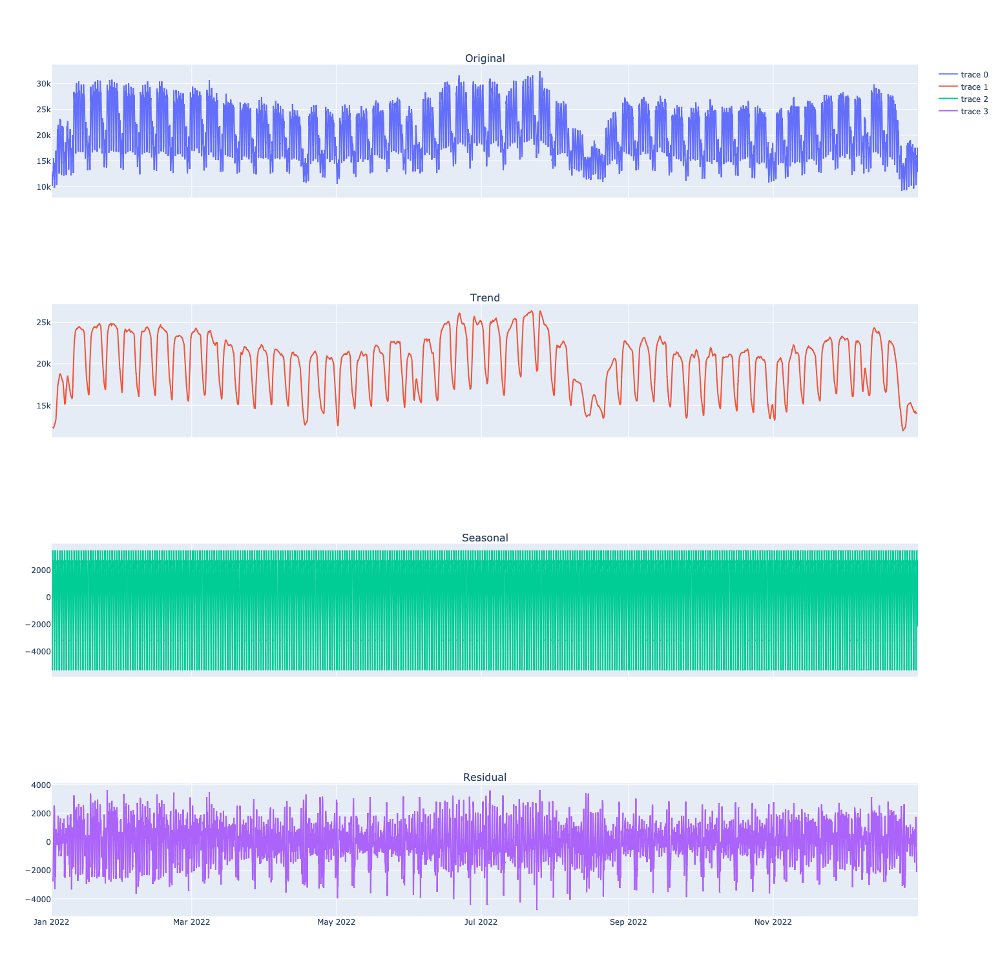

In [287]:
# Perform seasonal adjustment using STL decomposition
year = 2022
region = 'North'
ts = df.loc[df.index.year==year, region].asfreq('H')
ts.interpolate(limit=1, inplace=True)

result = sm.tsa.seasonal_decompose(ts)

# Plot the original, trend, seasonal, and residual components
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, subplot_titles=['Original', 'Trend', 'Seasonal', 'Residual'])

fig.add_trace(
    go.Scatter(
        y=ts,
        x=ts.index,
        mode="lines",
    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.trend,
        x=ts.index,
        mode="lines",
    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.seasonal,
        x=ts.index,
        mode="lines",
    ),
    row=3,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.resid,
        x=ts.index,
        mode="lines",
    ),
    row=4,
    col=1
)

fig.update_layout(height=1500, width=1500)

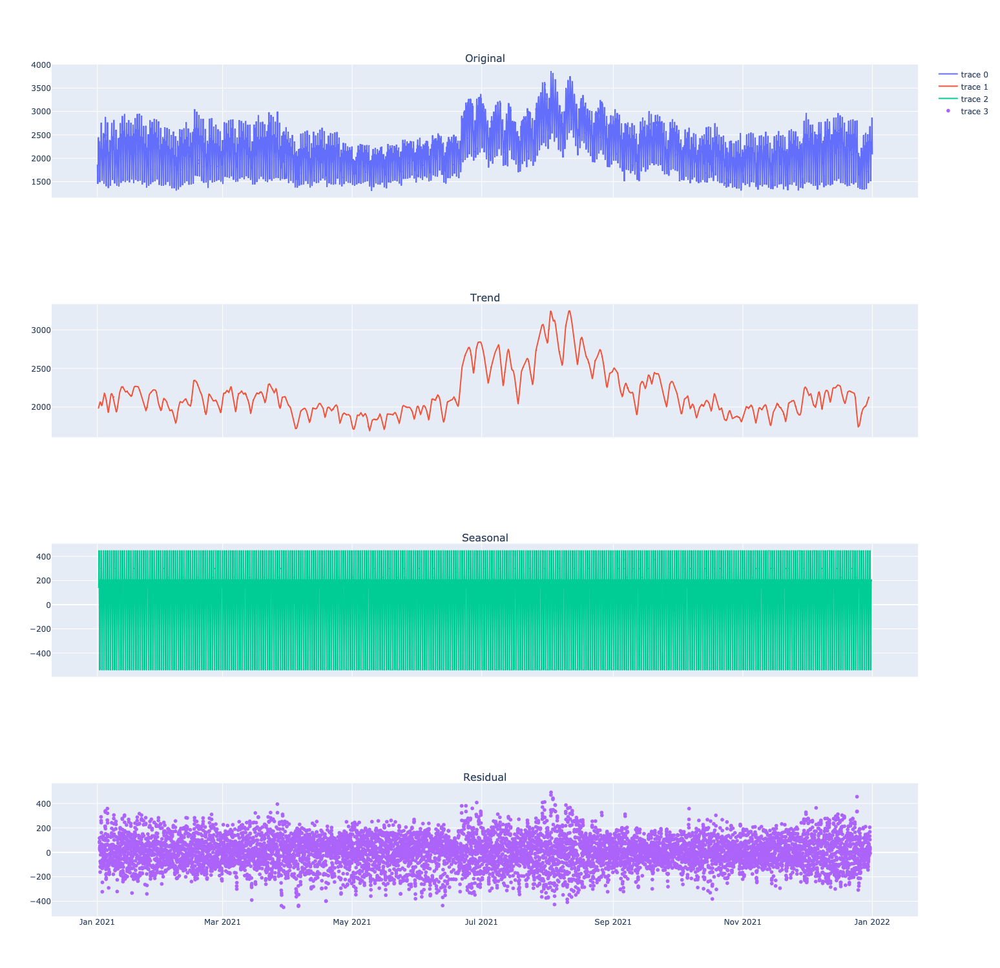

In [309]:
# Perform seasonal adjustment using STL decomposition
year = 2021
region = 'Sicily'
ts = df.loc[df.index.year==year, region].asfreq('H')
ts.interpolate(limit=1, inplace=True)

result = sm.tsa.seasonal_decompose(ts)

ts_new = result.trend

result2 = sm.tsa.seasonal_decompose(ts_new[~ts_new.isna()])

# Plot the original, trend, seasonal, and residual components
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, subplot_titles=['Original', 'Trend', 'Seasonal', 'Residual'])

fig.add_trace(
    go.Scatter(
        y=ts,
        x=ts.index,
        mode="lines",
    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result2.trend,
        x=ts.index,
        mode="lines",
    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.seasonal+result2.seasonal,
        x=ts.index,
        mode="lines",
    ),
    row=3,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.resid+result2.resid,
        x=ts.index,
        mode="markers",
    ),
    row=4,
    col=1
)

fig.update_layout(height=1500, width=1500)

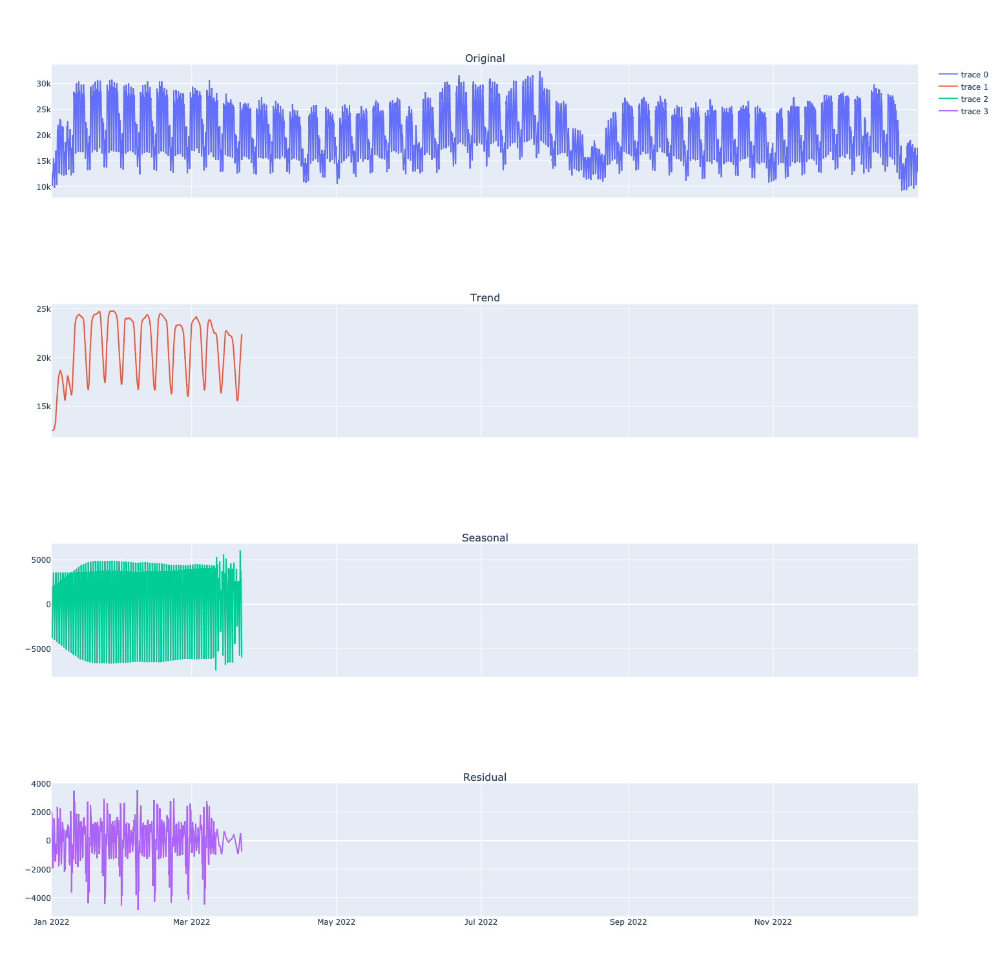

In [305]:
# Perform seasonal adjustment using STL decomposition
year = 2022
region = 'North'
ts = df.loc[df.index.year==year, region].asfreq('H')

stl = STL(ts.dropna().asfreq('H'), seasonal=25)
result = stl.fit()

ts_new = result.trend
result2 = STL(ts_new.dropna().asfreq('H'), seasonal=169).fit()

# Plot the original, trend, seasonal, and residual components
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, subplot_titles=['Original', 'Trend', 'Seasonal', 'Residual'])

fig.add_trace(
    go.Scatter(
        y=ts,
        x=ts.index,
        mode="lines",
    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result2.trend,
        x=ts.index,
        mode="lines",
    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.seasonal+result2.seasonal,
        x=ts.index,
        mode="lines",
    ),
    row=3,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.resid+result2.resid,
        x=ts.index,
        mode="lines",
    ),
    row=4,
    col=1
)

fig.update_layout(height=1500, width=1500)

<HR>

# TESTS

In [24]:
model = pd.read_csv('/Users/guillaume/Documents/GitHub/BSS/data/source_load/load_with_calendar.csv', index_col=0)

In [25]:
model.columns

Index(['Calabria', 'Centre-North', 'Centre-South', 'Italy', 'North',
       'Sardinia', 'Sicily', 'South', 'year', 'month_day', 'day', 'time',
       'weekday', 'weekofyear', 'monthofyear', 'hour', 'daytype'],
      dtype='object')

In [26]:
df = df[model.columns]
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day,day,time,weekday,weekofyear,monthofyear,hour,daytype
Date,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,NaN,2660.928,4292.272,24370.000,11776.405,942.891,1876.794,2820.710,2019,2020-01-01 00:00:00,2019-01-01,2020-01-01 00:00:00,Tuesday,1,1,0,Holiday
2019-01-01 01:00:00,NaN,2567.076,4147.282,23599.001,11559.374,894.427,1836.644,2594.198,2019,2020-01-01 01:00:00,2019-01-01,2020-01-01 01:00:00,Tuesday,1,1,1,Holiday
2019-01-01 02:00:00,NaN,2458.020,3994.622,22501.000,10916.388,862.613,1759.223,2510.134,2019,2020-01-01 02:00:00,2019-01-01,2020-01-01 02:00:00,Tuesday,1,1,2,Holiday
2019-01-01 03:00:00,NaN,2335.024,3691.788,21038.000,10194.686,829.157,1650.097,2337.248,2019,2020-01-01 03:00:00,2019-01-01,2020-01-01 03:00:00,Tuesday,1,1,3,Holiday
2019-01-01 04:00:00,NaN,2238.983,3436.792,19870.999,9562.170,809.330,1579.195,2244.529,2019,2020-01-01 04:00:00,2019-01-01,2020-01-01 04:00:00,Tuesday,1,1,4,Holiday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-31 19:00:00,791.814,2734.069,6110.321,31780.000,16288.086,1082.299,2464.776,2308.635,2023,2020-12-31 19:00:00,2023-12-31,2020-01-01 19:00:00,Sunday,52,12,19,Holiday
2023-12-31 20:00:00,757.054,2637.329,5856.124,30074.000,15265.633,1034.443,2335.105,2188.312,2023,2020-12-31 20:00:00,2023-12-31,2020-01-01 20:00:00,Sunday,52,12,20,Holiday
2023-12-31 21:00:00,674.156,2389.981,5376.828,27463.001,13917.284,958.273,2113.560,2032.919,2023,2020-12-31 21:00:00,2023-12-31,2020-01-01 21:00:00,Sunday,52,12,21,Holiday


In [27]:
df.to_csv('data/source_load/refresh_202402/load_2019_to_2023_with_calendar.csv')

In [ ]:
df[df.index.year == 2023].to_csv(f'data/source_load/refresh_202402/load_2023_with_calendar.csv')